### Todo

- INIT MODEL WITH CLASSIFIER MODEL WEIGHTS ✅
- FINE TUNE ✅
- ADD MORE AUGMENTATION (ZOOM, CROP ON DIFF BACK) 
- PREDICT WITH TTA 
- DISABLE BATCHNORM OR USE BATCH-RENORM

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import sys
import shutil
import os
from pathlib import Path
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split

In [2]:
sys.path.append("../fastai/old")
from fastai.conv_learner import *

### Train a detection/segmentation model for images with ships

**idea : rather than fine tuning imagenet for detection/segmentation fine tune with the fine tuned model for ship classifier** 

- train_seg_lbs : images in train_all folder with segmentation
- test_seg_lbs : images in test_all folder with segmentation

In [3]:
path = Path("../DATA/airbus-ship/")
files = list(path.iterdir())

In [4]:
files

[PosixPath('../DATA/airbus-ship/clean_has_ship_test.txt'),
 PosixPath('../DATA/airbus-ship/train'),
 PosixPath('../DATA/airbus-ship/train_ship_segmentations.csv'),
 PosixPath('../DATA/airbus-ship/segmentation'),
 PosixPath('../DATA/airbus-ship/submission'),
 PosixPath('../DATA/airbus-ship/test_v2'),
 PosixPath('../DATA/airbus-ship/tmp'),
 PosixPath('../DATA/airbus-ship/detection'),
 PosixPath('../DATA/airbus-ship/test_ship_segmentations.csv'),
 PosixPath('../DATA/airbus-ship/test_detection'),
 PosixPath('../DATA/airbus-ship/models'),
 PosixPath('../DATA/airbus-ship/classification'),
 PosixPath('../DATA/airbus-ship/clean_delete_train.txt'),
 PosixPath('../DATA/airbus-ship/clean_has_ship_train.txt'),
 PosixPath('../DATA/airbus-ship/test')]

### Recover segmentation data

In [19]:
train_images = ! ls {path}/"train"
test_images = ! ls {path}/"test"

In [17]:
train_segmentation = pd.read_csv(path/"train_ship_segmentations.csv")
test_segmentation = pd.read_csv(path/"test_ship_segmentations.csv")

In [24]:
all_segmentation = pd.concat([train_segmentation, test_segmentation])

In [26]:
trn_segmentation_df = all_segmentation[all_segmentation.ImageId.isin(train_images)]
test_segmentation_df = all_segmentation[all_segmentation.ImageId.isin(test_images)]

In [28]:
trn_segmentation_df.shape, test_segmentation_df.shape

((207548, 2), (24175, 2))

In [31]:
# remove images without ship
trn_segmentation_df = trn_segmentation_df[~trn_segmentation_df.EncodedPixels.isna()]
test_segmentation_df = test_segmentation_df[~test_segmentation_df.EncodedPixels.isna()]

In [32]:
os.makedirs(path/"segmentation", exist_ok=True)

In [33]:
trn_segmentation_df.reset_index(drop=True).to_csv(path/"segmentation/trn_segmentation.csv", index=False)
test_segmentation_df.reset_index(drop=True).to_csv(path/"segmentation/test_segmentation.csv", index=False)

### Visualize segmentation data

We exclude images without ship to deal with imbalance and focus on learning ship segmentation...

In [5]:
train_seg_lbs = pd.read_csv(path/"segmentation/trn_segmentation.csv")
test_seg_lbs = pd.read_csv(path/"segmentation/test_segmentation.csv")

In [6]:
print(f"# of train segmentation images: {train_seg_lbs.ImageId.nunique()}")
print(f"# of test segmentation images: {test_seg_lbs.ImageId.nunique()}")

# of train segmentation images: 38174
# of test segmentation images: 4382


In [7]:
print(f"# of train segmentation labels/ships: {len(train_seg_lbs.ImageId)}")
print(f"# of test segmentation labels/ships: {len(test_seg_lbs)}")

# of train segmentation labels/ships: 73166
# of test segmentation labels/ships: 8557


In [8]:
from rle import rle_decode, rle_encode
from seg_plots import show_img_masks, plot_segmentation_df

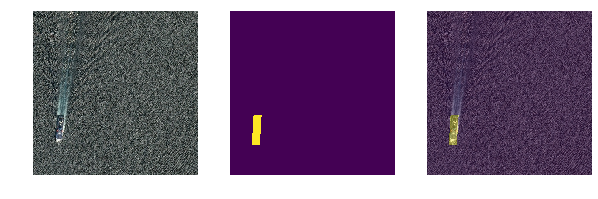

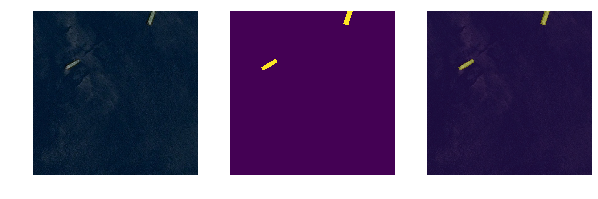

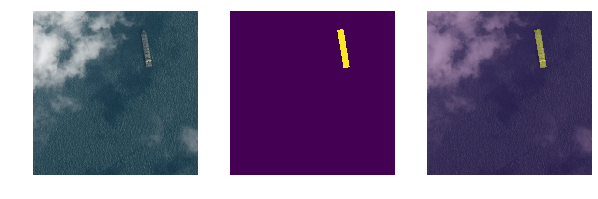

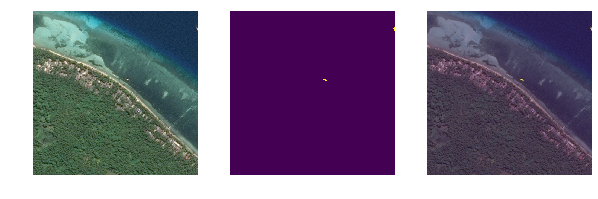

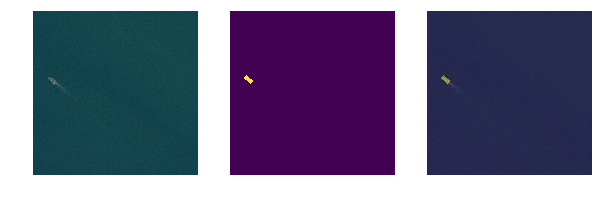

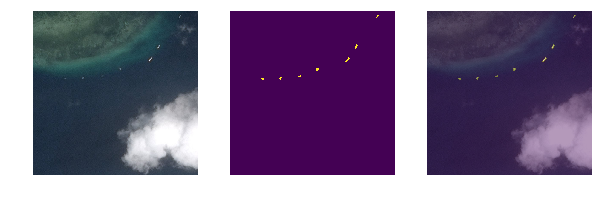

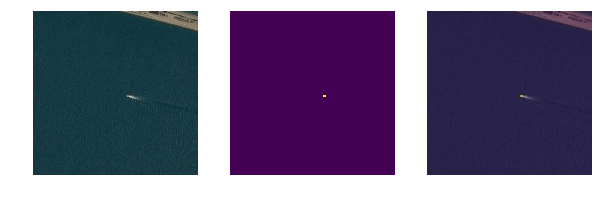

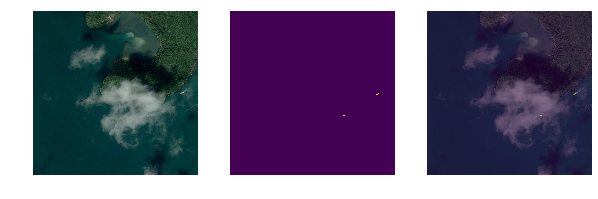

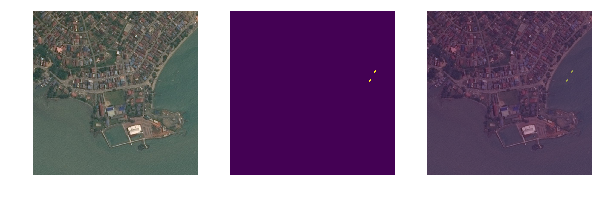

In [9]:
plot_segmentation_df(train_seg_lbs, path/'train', n=10, size=(10, 10))

### Save all masks 

Having rle_decode inside get_y is very expensive

In [68]:
from tqdm import tqdm
from concurrent.futures import as_completed
from concurrent.futures import ProcessPoolExecutor, ThreadPoolExecutor

def run_multi_progess(function, args_list, is_thread=True, **kwargs):
    # kwargs = {'unit': 'files','unit_scale': True, 'leave': True}
    if is_thread: executor = ThreadPoolExecutor(8)
    else: executor = ProcessPoolExecutor(4)
    with executor as e:
        futures = [e.submit(function, arg) for arg in args_list]
        for f in tqdm(as_completed(futures), total=len(futures), **kwargs):
            pass

In [69]:
trn_unique_img_ids = train_seg_lbs.ImageId.unique()
test_unique_img_ids = test_seg_lbs.ImageId.unique()

In [70]:
os.makedirs(path/'segmentation/train_masks', exist_ok=True)
os.makedirs(path/'segmentation/test_masks', exist_ok=True)

In [78]:
trn_unique_img_ids[:4]

array(['000155de5.jpg', '00021ddc3.jpg', '0002756f7.jpg', '00053c6ba.jpg'], dtype=object)

In [86]:
def save_train_mask(img_id):
    rles = train_seg_lbs[train_seg_lbs.ImageId == img_id]['EncodedPixels'].values
    masks = sum([rle_decode(rle, (768, 768)) for rle in rles])
    np.save(str(path/'segmentation/train_masks'/img_id), masks)

In [87]:
def save_test_mask(img_id):
    rles = test_seg_lbs[test_seg_lbs.ImageId == img_id]['EncodedPixels'].values
    masks = sum([rle_decode(rle, (768, 768)) for rle in rles])
    np.save(str(path/'segmentation/test_masks'/img_id), masks)

In [88]:
run_multi_progess(save_train_mask, trn_unique_img_ids, unit=' images')

100%|██████████| 38174/38174 [08:09<00:00, 77.99 images/s] 


In [89]:
run_multi_progess(save_test_mask, test_unique_img_ids, unit=' images')

100%|██████████| 4382/4382 [00:14<00:00, 302.45 images/s]


### Dynamic unet segmentation Model

In [5]:
from fastai.models.unet import *
from fastai.dataset import *
from fastai.core import *

In [6]:
train_seg_lbs = pd.read_csv(path/"segmentation/trn_segmentation.csv")
test_seg_lbs = pd.read_csv(path/"segmentation/test_segmentation.csv")

In [7]:
unique_img_ids = train_seg_lbs.ImageId.unique()
trn_fnames, val_fnames = train_test_split(unique_img_ids, test_size=0.1, random_state=42)

In [8]:
test_fnames = test_seg_lbs.ImageId.unique()

In [9]:
TRN_X = [f"train/{fname}" for fname in trn_fnames]
TRN_Y = [f"segmentation/train_masks/{fname}.npy" for fname in trn_fnames]

VAL_X = [f"train/{fname}" for fname in val_fnames]
VAL_Y = [f"segmentation/train_masks/{fname}.npy" for fname in val_fnames]

TEST_X = [f"test/{fname}" for fname in test_fnames]
TEST_Y = [f"segmentation/test_masks/{fname}.npy" for fname in test_fnames]

In [10]:
test_sub_fnames = list((path/"test_v2").glob("*.jpg"))

In [11]:
TEST_SUB_X = [f"test_v2/{fname.name}" for fname in test_sub_fnames]

In [12]:
TEST_SUB_X[:3]

['test_v2/c7b10873e.jpg', 'test_v2/563b384e1.jpg', 'test_v2/b51dde87a.jpg']

In [13]:
len(TRN_X), len(VAL_X), len(TEST_X), len(TEST_SUB_X)

(34356, 3818, 4382, 15606)

In [14]:
TRN_Y[:4]

['segmentation/train_masks/647be9508.jpg.npy',
 'segmentation/train_masks/39d765172.jpg.npy',
 'segmentation/train_masks/8977bc0a0.jpg.npy',
 'segmentation/train_masks/21f38f0b1.jpg.npy']

### Check masks

- Some masks are not separated

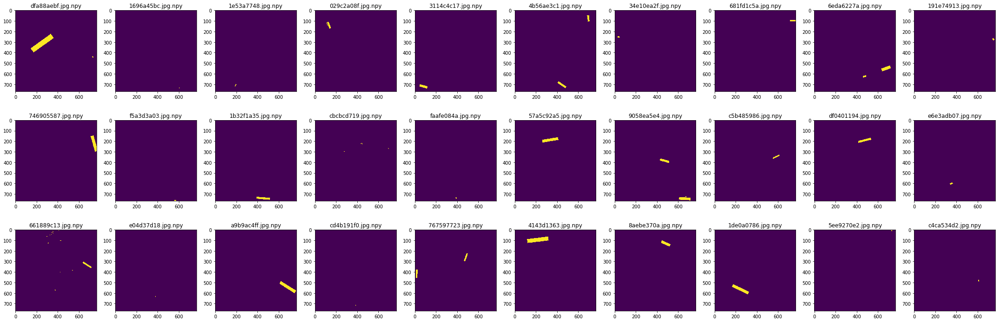

In [15]:
nrows = 3
fig, axes = plt.subplots(nrows, 10, figsize=(nrows*10, 10))
for i, ax in enumerate(axes.flatten()): 
    fname = np.random.permutation(VAL_Y)[i]
    ax.imshow(np.load(path/fname))
    ax.set_title(fname.split("/")[-1])
    
fig.tight_layout()

In [16]:
class FilesEncodedDataset(BaseDataset):
    def __init__(self, fnames, fnames2, transform, path):
        self.fnames = fnames
        self.fnames2 = fnames2
        self.path = path
        super().__init__(transform)
    
    def get_sz(self): return self.transform.sz
    def get_x(self, i): return open_image(os.path.join(self.path, self.fnames[i]))
    def get_y(self, i): 
        
        mask = np.load(os.path.join(self.path, self.fnames2[i])).astype('float32')
        #mask = cv2.resize(mask, (sz, sz)).astype('float32')
        #mask = np.round(mask)
        return mask
        
    def get_n(self): return len(self.fnames)
    def get_c(self): return 0

    def resize_imgs(self, targ, new_path):
        dest = resize_imgs(self.fnames, targ, self.path, new_path)
        return self.__class__(self.fnames, self.y, self.transform, dest)

    def denorm(self,arr):
        """Reverse the normalization done to a batch of images.

        Arguments:
            arr: of shape/size (N,3,sz,sz)
        """
        if type(arr) is not np.ndarray: arr = to_np(arr)
        if len(arr.shape)==3: arr = arr[None]
        return self.transform.denorm(np.rollaxis(arr,1,4))

In [17]:
class Transform():
    """ A class that represents a transform.

    All other transforms should subclass it.
    All subclasses should override
    do_transform.

    Arguments
    ---------
        tfm_y : TfmType
            type of transform
    """
    def __init__(self, tfm_y=TfmType.NO):
        self.tfm_y=tfm_y
        self.store = threading.local()

    def set_state(self): pass
    def __call__(self, x, y):
        self.set_state()
        x,y = ((self.transform(x),y) if self.tfm_y==TfmType.NO
                else self.transform(x,y) if self.tfm_y in (TfmType.PIXEL, TfmType.CLASS)
                else self.transform_coord(x,y))
        return x, y

    def transform_coord(self, x, y): return self.transform(x),y

    def transform(self, x, y=None):
        x = self.do_transform(x,False)
        return (x, self.do_transform(y,True)) if y is not None else x

    @abstractmethod
    def do_transform(self, x, is_y): raise NotImplementedError

In [18]:
class RandomLighting(Transform):
    def __init__(self, b, c, tfm_y=TfmType.NO):
        super().__init__(tfm_y)
        self.b,self.c = b,c

    def set_state(self):
        self.store.b_rand = rand0(self.b)
        self.store.c_rand = rand0(self.c)

    def do_transform(self, x, is_y):
        if is_y and self.tfm_y != TfmType.PIXEL: return x
        b = self.store.b_rand
        c = self.store.c_rand
        c = -1/(c-1) if c<0 else c+1
        x = lighting(x, b, c)
        return x

In [19]:
class RandomDihedral(CoordTransform):
    """
    Rotates images by random multiples of 90 degrees and/or reflection.
    Please reference D8(dihedral group of order eight), the group of all symmetries of the square.
    """
    def set_state(self):
        self.store.rot_times = random.randint(0,3)
        self.store.do_flip = random.random()<0.5

    def do_transform(self, x, is_y):
        x = np.rot90(x, self.store.rot_times)
        return np.fliplr(x).copy() if self.store.do_flip else x

In [20]:
#RandomRotate(deg=30, p=0.7, tfm_y=TfmType.PIXEL)
f = resnet34
sz = 768
tfms = tfms_from_model(f,
                       sz,
                       aug_tfms=[RandomDihedral(tfm_y=TfmType.PIXEL),
                                 RandomBlur(),
                                 RandomLighting(0.05, 0.05)],
                       tfm_y=TfmType.PIXEL,
                       norm_y=False,
                       crop_type=CropType.NO) 

In [21]:
dataset = ImageData.get_ds(FilesEncodedDataset, 
                           trn=(TRN_X, TRN_Y),
                           val=(VAL_X, VAL_Y), tfms=tfms,
                           test=(TEST_X, TEST_X) ,path=path)

In [22]:
md = ImageData(path, dataset, bs=4, num_workers=8, classes=None)

In [23]:
denorm = md.trn_ds.denorm

In [24]:
*x, y= next(iter(md.trn_dl))

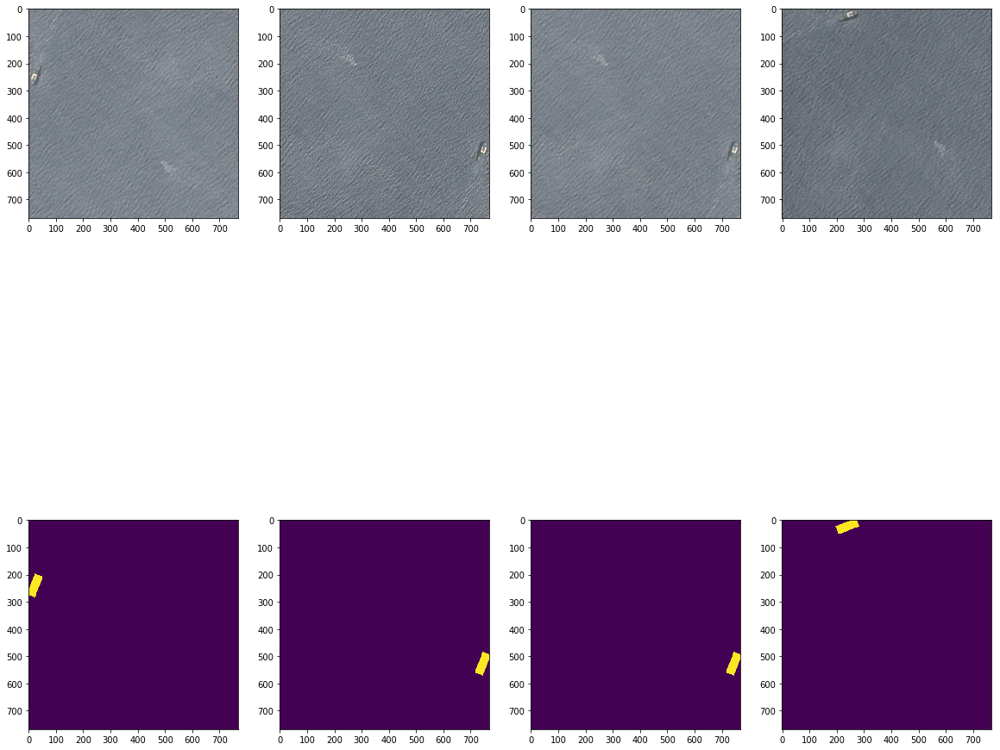

In [38]:
# plot augmentations
i = 0

fig_sz = (20, 20)
fig, axes = plt.subplots(2, 4, figsize=fig_sz)
for ax in np.rollaxis(axes, -1):
    x,y = next(iter(md.aug_dl))
    img = denorm(x)[i]
    ax[0].imshow(img)
    ax[1].imshow(to_np(y[i]))

In [39]:
np.unique(to_np(y[i]))

array([0., 1.], dtype=float32)

In [25]:
print(f"n train: {len(md.trn_ds)}, n val: {len(md.val_ds)}, n test: {len(md.test_ds)}")

n train: 34356, n val: 3818, n test: 4382


### Model

In [26]:
# load defined model# load  
def get_encoder(f, cut):
    base_model = (cut_model(f(True), cut))
    return nn.Sequential(*base_model)

def get_model(f=resnet18, sz=128):
    """gets dynamic unet model"""
    # cut encoder
    cut, cut_lr = model_meta[f]

    # define encoder
    encoder = get_encoder(f, cut)

    # init model
    # binary: ship - not ship
    m = DynamicUnet(encoder, n_classes=1) 

    # init upsample on cpu
    inp = torch.ones(1, 3, sz, sz)
    out = m(V(inp).cpu())

    # put model to gpu if desired# put mo 
    m = m.cuda(0)
    return m

In [27]:
def dice_loss(logits, target):
    logits = torch.sigmoid(logits)
    smooth = 1.0

    iflat = logits.view(-1)
    tflat = target.view(-1)
    intersection = (iflat * tflat).sum()
    
    return ((2.0 * intersection + smooth) / (iflat.sum() + tflat.sum() + smooth))

In [28]:
class FocalLoss(nn.Module):
    def __init__(self, gamma):
        super().__init__()
        self.gamma = gamma
        
    def forward(self, logits, target):
        logits = logits.squeeze(1)
        if not (target.size() == logits.size()):
            raise ValueError("Target size ({}) must be the same as input size ({})"
                             .format(target.size(), logits.size()))

        max_val = (-logits).clamp(min=0)
        loss = logits - logits * target + max_val + \
            ((-max_val).exp() + (-logits - max_val).exp()).log()

        invprobs = F.logsigmoid(-logits * (target * 2.0 - 1.0))
        loss = (invprobs * self.gamma).exp() * loss
        
        return loss.mean()

In [29]:
class BCELoss2D(nn.Module):
    def __init__(self):
        super(BCELoss2D, self).__init__()
        
    def forward(self, logits, targets):
        logits = logits.squeeze(1)
        logits = F.sigmoid(logits)
        return F.binary_cross_entropy(logits, targets)

In [30]:
class MixedLoss(nn.Module):
    def __init__(self, alpha, gamma):
        super().__init__()
        self.alpha = alpha
        self.focal = FocalLoss(gamma)
        
    def forward(self, input, target):
        loss = self.alpha*self.focal(input, target) - torch.log(dice_loss(input, target))
        return loss.mean()

In [31]:
class UpsampleModel():
    def __init__(self, model, cut_lr, name='upsample'):
        self.model,self.name, self.cut_lr = model, name, cut_lr

    def get_layer_groups(self, precompute):
        lgs = list(split_by_idxs(children(self.model.encoder), [self.cut_lr]))
        return lgs + [children(self.model)[1:]]

### Test metric

ref: https://www.kaggle.com/stkbailey/step-by-step-explanation-of-scoring-metric

In [32]:
from skimage.measure import label
from eval_metric import sigmoid, get_gt_masks, create_iou_matrix, f2_IOU, get_pred_masks

In [33]:
def single_image_score(labels, gt_rles, gt):
    """return avg thresholded f2 score for single image"""
    if len(np.unique(labels)) == 1:
        if gt is None: 
            """original image has no instance"""
            return 1
        else:
            """no prediction is made tp = 0"""
            return 0
    else:
        pred_mask_arrays = get_pred_masks(labels)
        gt_mask_arrays = get_gt_masks(gt_rles)
        IOU = create_iou_matrix(pred_mask_arrays, gt_mask_arrays)
        return f2_IOU(IOU)

In [34]:
shift = 0 # shift to keep track of file index 
n_valids = len(md.val_ds) # total # of validation samples
fnames = md.val_ds.fnames # validation filenames
df = train_seg_lbs

def fastai_metric(preds, targs):
    global shift
    global df
    global fnames
    global n_valids
    
    mask_thresh = 0.5 
    n_x = len(preds)

    scores = [] 
    preds = (sigmoid(to_np(preds).squeeze(1)) > mask_thresh).astype('uint8')
    gts = to_np(targs)
    
    for i, (gt_i, pred_i) in enumerate(zip(gts, preds)):
        fname = fnames[i+shift]
        gt_rles = df[df.ImageId == fname.split("/")[-1]]['EncodedPixels'].values
        labels = label(pred_i)
        scores.append(single_image_score(labels, gt_rles, gt_i))

    shift += n_x
    if shift == n_valids: shift = 0
    return np.mean(scores)

### Train with eval metric

In [35]:
init_model = False
f = resnet34
cut, cut_lr = model_meta[f]
model = get_model(f, sz=768)
models = UpsampleModel(model, cut_lr)

if init_model:
    cls_weights = torch.load(path/"models/resnet34_classification_ft_v2.224.h5")
    state_dict_keys = list(model.encoder.state_dict().keys())
    for k in state_dict_keys: model.encoder.state_dict()[k].copy_(cls_weights[k])

learn = ConvLearner(md, models)
learn.opt_fn=optim.Adam
learn.crit = MixedLoss(10, 2)
learn.metrics = [fastai_metric]

In [76]:
md.bs

4

In [79]:
learn.lr_find()

 66%|██████▌   | 5680/8589 [28:08<08:27,  5.73it/s, loss=1.89]   

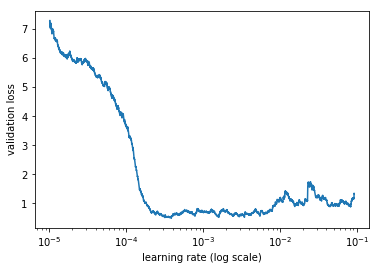

In [80]:
learn.sched.plot()

In [ ]:
learn.fit(3e-4, n_cycle=10, cycle_len=10, use_clr=(20, 10))

 70%|██████▉   | 6011/8589 [29:35<29:17,  1.47it/s, loss=0.448]  

In [32]:
# save model
learn.save("resnet34_segmentation_v2.768")

### Fine tuning

In [40]:
learn.load("resnet34_segmentation_v2.768")

In [ ]:
learn.unfreeze()
lr = 1e-3
lrs = [lr/100, lr/10, lr]
learn.fit(lrs, n_cycle=1, cycle_len=8)

In [33]:
learn.save("resnet34_segmentation_ft_v2.768")

In [31]:
learn.load("resnet34_segmentation_ft_v2.768")

### Visualize predictions

In [63]:
learn.load("resnet34_segmentation_ft_v2.768")

In [64]:
from seg_plots import plot_batch

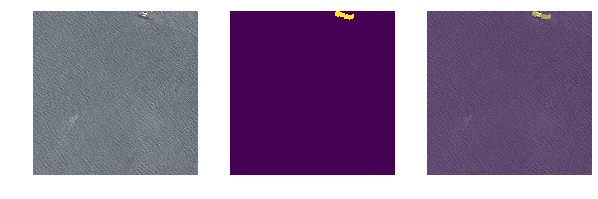

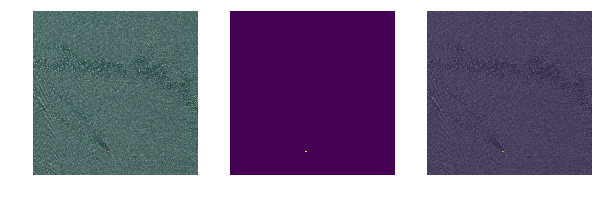

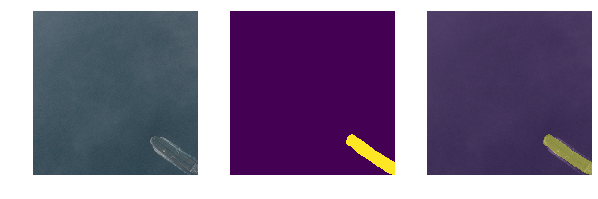

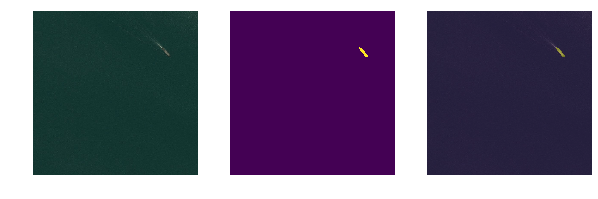

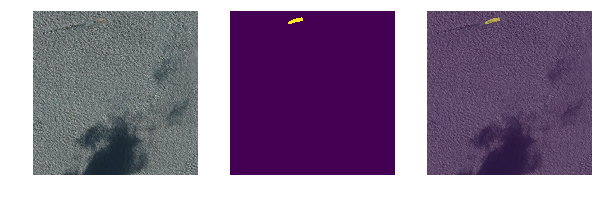

...

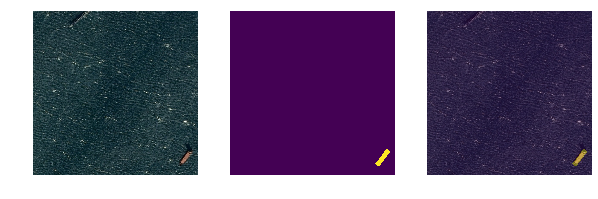

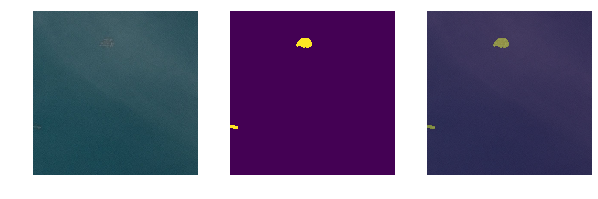

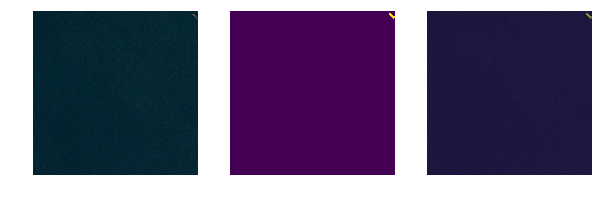

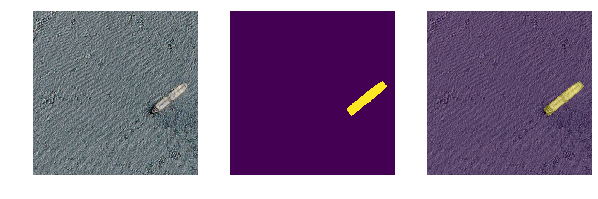

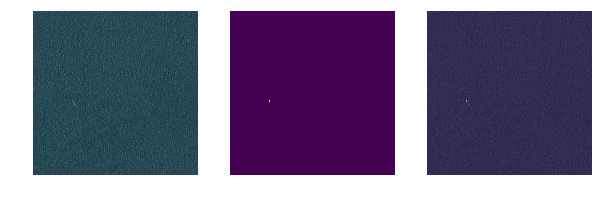

In [66]:
plot_batch(path,
           learn.model.train(),
           learn.data.val_dl,
           learn.data.val_ds.fnames,
           15)

### Segmentation submission

In [67]:
from rle import rle_encode

In [68]:
classification_preds = pd.read_csv(path/"classification/test_preds_resnet50_224_ft.csv")

In [69]:
classification_preds.head()

,ImageId,has_ship_proba
0,c7b10873e.jpg,0.003826
1,563b384e1.jpg,0.034732
2,b51dde87a.jpg,0.000413
3,521d1426a.jpg,0.004082
4,4b3ca4cb6.jpg,0.003905


In [70]:
sum(classification_preds.has_ship_proba > 0.5)

3029

In [71]:
has_ship_images = classification_preds[classification_preds.has_ship_proba > 0.5]["ImageId"].values

In [72]:
test_seg_fnames = [f"test_v2/{fname}" for fname in has_ship_images]

In [73]:
TEST_SUB_X = test_seg_fnames
TEST_SUB_Y = TRN_Y[:len(test_seg_fnames)]

In [74]:
len(TEST_SUB_X)

3029

In [75]:
#RandomRotate(deg=30, p=0.7, tfm_y=TfmType.PIXEL)
f = resnet34
sz = 768
tfms = tfms_from_model(f,
                       sz,
                       aug_tfms=[RandomDihedral(tfm_y=TfmType.PIXEL),
                                 RandomBlur(),
                                 RandomLighting(0.05, 0.05)],
                       tfm_y=TfmType.PIXEL,
                       norm_y=False,
                       crop_type=CropType.NO) 

In [76]:
dataset = ImageData.get_ds(FilesEncodedDataset, 
                           trn=(TRN_X, TRN_Y),
                           val=(VAL_X, VAL_Y), tfms=tfms,
                           test=(TEST_SUB_X, TEST_SUB_Y) ,path=path)

In [77]:
md = ImageData(path, dataset, bs=4, num_workers=8, classes=None)

In [78]:
f = resnet34
cut, cut_lr = model_meta[f]
model = get_model(f, sz=768)
models = UpsampleModel(model, cut_lr)

learn = ConvLearner(md, models)
learn.opt_fn=optim.Adam
learn.crit = MixedLoss(10, 2)
learn.metrics = [fastai_metric]

In [174]:
learn.load("resnet34_segmentation.768")

In [195]:
# make preds at train mode
model = learn.model.eval()

In [196]:
test_preds = []
for x, y in iter(learn.data.test_dl):
    out = to_np(model(V(x)))
    test_preds.append(out)

In [197]:
#test_preds = learn.predict(is_test=True)

In [198]:
# # TODO: test TTA
# class RandomDihedral(CoordTransform):
#     """
#     Rotates images by random multiples of 90 degrees and/or reflection.
#     Please reference D8(dihedral group of order eight), the group of all symmetries of the square.
#     """
#     def set_state(self):
#         self.store.rot_times = random.randint(0,3)
#         self.store.do_flip = random.random()<0.5

#     def do_transform(self, x, is_y):
#         x = np.rot90(x, self.store.rot_times)
#         return np.fliplr(x).copy() if self.store.do_flip else x



In [199]:
test_preds2 = [pred.squeeze(1) for pred in test_preds]

In [200]:
test_preds3 = []
for preds in test_preds2:
    for pred in preds:
        test_preds3.append(pred)

In [201]:
test_preds = [sigmoid(pred) for pred in test_preds3]

In [202]:
#test_preds = [sigmoid(pred.squeeze(1)) for pred in test_preds]
test_fnames = [fname.split("/")[1] for fname in learn.data.test_ds.fnames]

In [203]:
test_fnames[:4]

['70a5ee217.jpg', '6908d991d.jpg', 'fd4862ad6.jpg', 'baea538f3.jpg']

In [204]:
len(test_preds), len(test_fnames)

(3029, 3029)

In [205]:
from seg_plots import show_img_masks

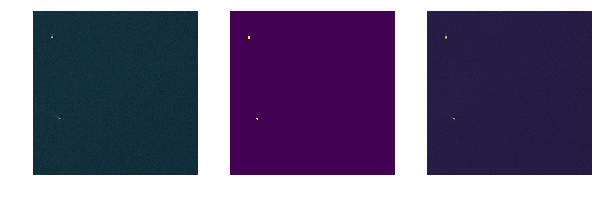

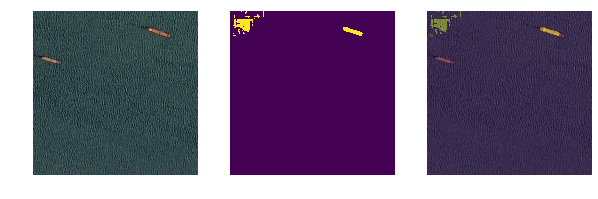

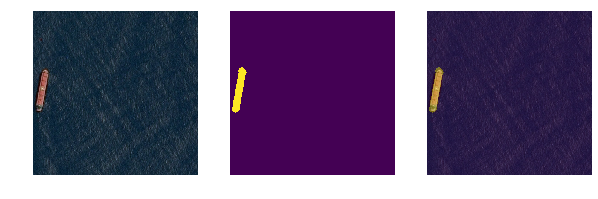

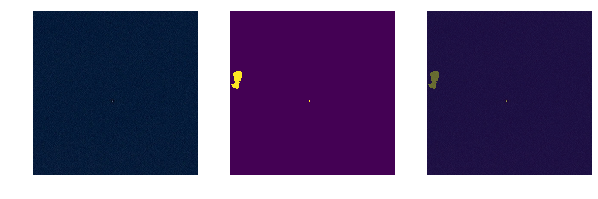

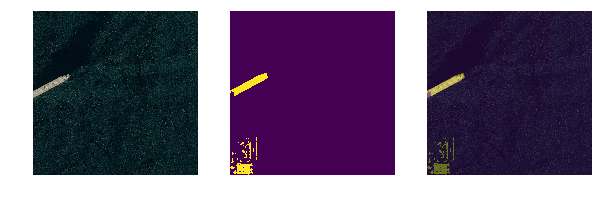

...

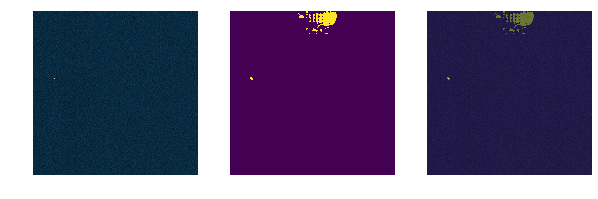

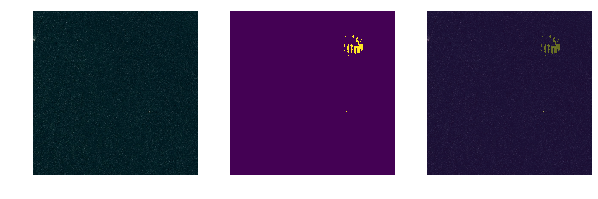

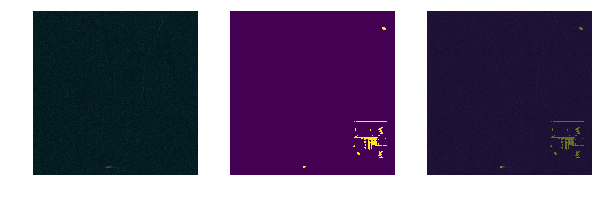

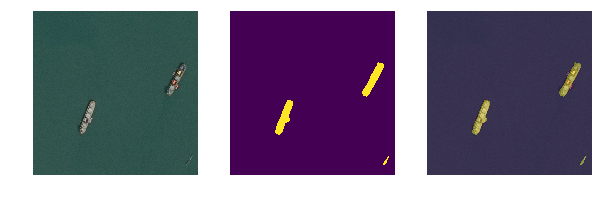

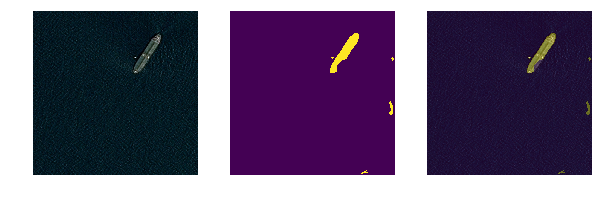

In [206]:
for i in range(100):
    show_img_masks(open_image(path/f"test_v2/{test_fnames[i]}"), (test_preds[i] > 0.5))

In [207]:
long_preds = []
for fname, pred in zip(test_fnames, test_preds):
    labels = label(pred > 0.5)
    pred_masks = get_pred_masks(labels, sz=None)
    if pred_masks == []:
        long_preds.append((fname, None))
    else:
        for pred_mask in pred_masks:
            long_preds.append((fname, rle_encode(pred_mask)))

In [208]:
segmentation_preds = pd.DataFrame(list(zip(*long_preds))).T.\
                rename(columns={0:"ImageId", 1:"EncodedPixels"})

In [209]:
segmentation_preds.ImageId.nunique()

3029

In [210]:
no_ship_img_ids = classification_preds[classification_preds.has_ship_proba <=0.5]["ImageId"].values

In [211]:
no_ship_df = pd.DataFrame({"ImageId": no_ship_img_ids, "EncodedPixels":None})

In [212]:
submission_df = pd.concat([no_ship_df, segmentation_preds])

In [213]:
submission_df.head()

,ImageId,EncodedPixels
0,c7b10873e.jpg,None
1,563b384e1.jpg,None
2,b51dde87a.jpg,None
3,521d1426a.jpg,None
4,4b3ca4cb6.jpg,None


In [214]:
path

PosixPath('../DATA/airbus-ship')

In [215]:
submission_df.to_csv(path/"submission/resnet_50_cls_224_resnet_34_seg_eval_768.csv", index=False)

In [216]:
FileLink(path/"submission/resnet_50_cls_224_resnet_34_seg_eval_768.csv")

/home/ubuntu/DATA/airbus-ship/submission/resnet_50_cls_224_resnet_34_seg_eval_768.csv